<a href="https://colab.research.google.com/github/sainisatish/Aashay-The-Bot/blob/master/Final_Result.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# YOLO V3
Darknet-53 Framework




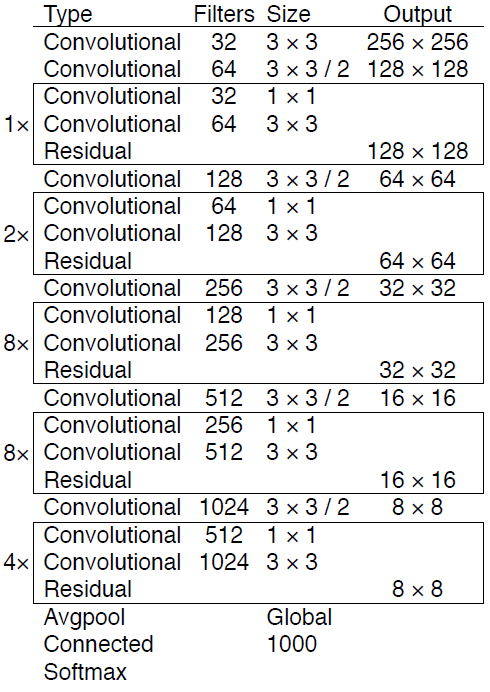

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [1]:
import tensorflow as tf
from tensorflow.keras import Model
import numpy as np
import cv2
import time
from tensorflow.keras.layers import BatchNormalization, Conv2D, \
    Input, ZeroPadding2D, LeakyReLU, UpSampling2D


# Parse Configuration file

In [2]:
def parse_cfg(cfgfile):
    with open(cfgfile, 'r') as file:
        lines = [line.rstrip('\n') for line in file if line != '\n' and line[0] != '#']
    holder = {}
    blocks = []
    for line in lines:
        if line[0] == '[':
            line = 'type=' + line[1:-1].rstrip()
            if len(holder) != 0:
                blocks.append(holder)
                holder = {}
        key, value = line.split("=")
        holder[key.rstrip()] = value.lstrip()
    blocks.append(holder)
    return blocks

# Design Yolo V3 architecture

In [3]:
def YOLOv3Net(cfgfile, model_size, num_classes):
    blocks = parse_cfg(cfgfile)
    outputs = {}
    output_filters = []
    filters = []
    out_pred = []
    scale = 0
    inputs = input_image = Input(shape=model_size)
    inputs = inputs / 255.0
    for i, block in enumerate(blocks[1:]):
        if (block["type"] == "convolutional"):
            activation = block["activation"]
            filters = int(block["filters"])
            kernel_size = int(block["size"])
            strides = int(block["stride"])
            if strides > 1:
                inputs = ZeroPadding2D(((1, 0), (1, 0)))(inputs)
            inputs = Conv2D(filters,
                            kernel_size,
                            strides=strides,
                            padding='valid' if strides > 1 else 'same',
                            name='conv_' + str(i),
                            use_bias=False if ("batch_normalize" in block) else True)(inputs)
            if "batch_normalize" in block:
                inputs = BatchNormalization(name='bnorm_' + str(i))(inputs)
                inputs = LeakyReLU(alpha=0.1, name='leaky_' + str(i))(inputs)
        elif (block["type"] == "upsample"):
            stride = int(block["stride"])
            inputs = UpSampling2D(stride)(inputs)
        elif (block["type"] == "route"):
            block["layers"] = block["layers"].split(',')
            start = int(block["layers"][0])
            if len(block["layers"]) > 1:
                end = int(block["layers"][1]) - i
                filters = output_filters[i + start] + output_filters[end]  
                inputs = tf.concat([outputs[i + start], outputs[i + end]], axis=-1)
            else:
                filters = output_filters[i + start]
                inputs = outputs[i + start]
        elif block["type"] == "shortcut":
            from_ = int(block["from"])
            inputs = outputs[i - 1] + outputs[i + from_]
        elif block["type"] == "yolo":
            mask = block["mask"].split(",")
            mask = [int(x) for x in mask]
            anchors = block["anchors"].split(",")
            anchors = [int(a) for a in anchors]
            anchors = [(anchors[i], anchors[i + 1]) for i in range(0, len(anchors), 2)]
            anchors = [anchors[i] for i in mask]
            n_anchors = len(anchors)
            out_shape = inputs.get_shape().as_list()
            inputs = tf.reshape(inputs, [-1, n_anchors * out_shape[1] * out_shape[2], \
           5 + num_classes])
            box_centers = inputs[:, :, 0:2]
            box_shapes = inputs[:, :, 2:4]
            confidence = inputs[:, :, 4:5]
            classes = inputs[:, :, 5:num_classes + 5]
            box_centers = tf.sigmoid(box_centers)
            confidence = tf.sigmoid(confidence)
            classes = tf.sigmoid(classes)
            anchors = tf.tile(anchors, [out_shape[1] * out_shape[2], 1])
            box_shapes = tf.exp(box_shapes) * tf.cast(anchors, dtype=tf.float32)
            x = tf.range(out_shape[1], dtype=tf.float32)
            y = tf.range(out_shape[2], dtype=tf.float32)
            cx, cy = tf.meshgrid(x, y)
            cx = tf.reshape(cx, (-1, 1))
            cy = tf.reshape(cy, (-1, 1))
            cxy = tf.concat([cx, cy], axis=-1)
            cxy = tf.tile(cxy, [1, n_anchors])
            cxy = tf.reshape(cxy, [1, -1, 2])
            strides = (input_image.shape[1] // out_shape[1], \
                       input_image.shape[2] // out_shape[2])
            box_centers = (box_centers + cxy) * strides
            prediction = tf.concat([box_centers, box_shapes, confidence, classes], axis=-1)
            if scale:
                out_pred = tf.concat([out_pred, prediction], axis=1)
            else:
                out_pred = prediction
                scale = 1
        outputs[i] = inputs
        output_filters.append(filters)
    model = Model(input_image, out_pred)
    model.summary()
    return model

In [7]:
model_size = (416, 416,3)
num_classes = 3
cfgfile = '/content/drive/MyDrive/Part_two/darknet/cfg/yolov3_custom.cfg'
#cfgfile = '/content/drive/MyDrive/darknet/cfg/yolov3_custom.cfg'

In [ ]:
model = YOLOv3Net(cfgfile,model_size,num_classes)

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 416, 416, 3) 0                                            
__________________________________________________________________________________________________
tf.math.truediv (TFOpLambda)    (None, 416, 416, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv_0 (Conv2D)                 (None, 416, 416, 32) 864         tf.math.truediv[0][0]            
__________________________________________________________________________________________________
bnorm_0 (BatchNormalization)    (None, 416, 416, 32) 128         conv_0[0][0]                     
______________________________________________________________________________________________

In [ ]:
tf.keras.utils.plot_model(
    model,
    to_file="model.png",
    show_shapes=False,
    show_dtype=False,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=False,
    dpi=96,
)

In [ ]:
 # del(model)

# Converting Weights To Keras format

In [6]:
def load_weights(model,cfgfile,weightfile):
    fp = open(weightfile, "rb")
    np.fromfile(fp, dtype=np.int32, count=5)
    blocks = parse_cfg(cfgfile)
    for i, block in enumerate(blocks[1:]):
        if (block["type"] == "convolutional"):
            conv_layer = model.get_layer('conv_' + str(i))
            print("layer: ",i+1,conv_layer)
            filters = conv_layer.filters
            k_size = conv_layer.kernel_size[0]
            in_dim = conv_layer.input_shape[-1]
            if "batch_normalize" in block:
                norm_layer = model.get_layer('bnorm_' + str(i))
                print("layer: ",i+1,norm_layer)
                size = np.prod(norm_layer.get_weights()[0].shape)
                bn_weights = np.fromfile(fp, dtype=np.float32, count=4 * filters)
                bn_weights = bn_weights.reshape((4, filters))[[1, 0, 2, 3]]
            else:
                conv_bias = np.fromfile(fp, dtype=np.float32, count=filters)
            conv_shape = (filters, in_dim, k_size, k_size)
            conv_weights = np.fromfile(
                fp, dtype=np.float32, count=np.product(conv_shape))
            conv_weights = conv_weights.reshape(
                conv_shape).transpose([2, 3, 1, 0])
            if "batch_normalize" in block:
                norm_layer.set_weights(bn_weights)
                conv_layer.set_weights([conv_weights])
            else:
                conv_layer.set_weights([conv_weights, conv_bias])
    assert len(fp.read()) == 0, 'failed to read all data'
    fp.close()

# Saving weights

In [8]:
weightfile = "/content/drive/MyDrive/Part_two/darknet/backup/yolov3_custom_900.weights"
#weightfile = "/content/drive/MyDrive/darknet/backup/yolov3_custom_900.weights"
model_size = (416, 416, 3)
num_classes = 3
model=YOLOv3Net(cfgfile,model_size,num_classes)
load_weights(model,cfgfile,weightfile)
try:
    model.save_weights('weights/yolov3_weights.tf')
    print('\nThe file \'yolov3_weights.tf\' has been saved successfully.')
except IOError:
    print("Couldn't write the file \'yolov3_weights.tf\'.")

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 416, 416, 3) 0                                            
__________________________________________________________________________________________________
tf.math.truediv (TFOpLambda)    (None, 416, 416, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv_0 (Conv2D)                 (None, 416, 416, 32) 864         tf.math.truediv[0][0]            
__________________________________________________________________________________________________
bnorm_0 (BatchNormalization)    (None, 416, 416, 32) 128         conv_0[0][0]                     
______________________________________________________________________________________________

In [ ]:
model.load_weights("/content/weights/yolov3_weights.tf")

In [58]:
max_output_size = 30
max_output_size_per_class= 10
iou_threshold = 0.2
confidence_threshold = 0.1
model_size = (416, 416,3)
num_classes = 3
class_name = '/content/drive/MyDrive/Part_two/darknet/cfg/obj.names'
#class_name = '/content/drive/MyDrive/darknet/cfg/obj.names'
#cfgfile = '/content/drive/MyDrive/darknet/cfg/yolov3_custom.cfg'
weightfile = '/content/weights/yolov3_weights.tf'

# Non maximum suppression Function

In [10]:
def non_max_suppression(inputs, model_size, max_output_size,
                        max_output_size_per_class, iou_threshold,
                        confidence_threshold):
    bbox, confs, class_probs = tf.split(inputs, [4, 1, -1], axis=-1)
    bbox=bbox/model_size[0]
    scores = confs * class_probs
    boxes, scores, classes, valid_detections = \
        tf.image.combined_non_max_suppression(
        boxes=tf.reshape(bbox, (tf.shape(bbox)[0], -1, 1, 4)),
        scores=tf.reshape(scores, (tf.shape(scores)[0], -1,
                                   tf.shape(scores)[-1])),
        max_output_size_per_class=max_output_size_per_class,
        max_total_size=max_output_size,
        iou_threshold=iou_threshold,
        score_threshold=confidence_threshold
    )
    return boxes, scores, classes, valid_detections

# Output decoding and Image Utility function

In [11]:
def resize_image(inputs, modelsize):
    inputs= tf.image.resize(inputs, modelsize)
    return inputs

def load_class_names(file_name):
    with open(file_name, 'r') as f:
        class_names = f.read().splitlines()
    return class_names

def output_boxes(inputs,model_size, max_output_size, max_output_size_per_class,
                 iou_threshold, confidence_threshold):
    center_x, center_y, width, height, confidence, classes = \
        tf.split(inputs, [1, 1, 1, 1, 1, -1], axis=-1)
    top_left_x = center_x - width / 2.0
    top_left_y = center_y - height / 2.0
    bottom_right_x = center_x + width / 2.0
    bottom_right_y = center_y + height / 2.0
    inputs = tf.concat([top_left_x, top_left_y, bottom_right_x,
                        bottom_right_y, confidence, classes], axis=-1)
    boxes_dicts = non_max_suppression(inputs, model_size, max_output_size,
                                      max_output_size_per_class, iou_threshold, confidence_threshold)
    return boxes_dicts
def draw_outputs(img, boxes, objectness, classes, nums, class_names):
    boxes, objectness, classes, nums = boxes[0], objectness[0], classes[0], nums[0]
    boxes=np.array(boxes)
    for i in range(nums):
        x1y1 = tuple((boxes[i,0:2] * [img.shape[1],img.shape[0]]).astype(np.int32))
        x2y2 = tuple((boxes[i,2:4] * [img.shape[1],img.shape[0]]).astype(np.int32))
        img = cv2.rectangle(img, (x1y1), (x2y2), (255,0,0), 2)
        img = cv2.putText(img, '{} {:.4f}'.format(
            class_names[int(classes[i])], objectness[i]),
                          (x1y1), cv2.FONT_HERSHEY_PLAIN, 1, (0, 0, 255), 2)
    return img

# Final Result

In [12]:
from google.colab.patches import cv2_imshow

In [13]:
class_names = load_class_names(class_name)

In [26]:
def show_output(img_path):
    image = cv2.imread(img_path)
    image = np.array(image)
    image = tf.expand_dims(image, 0)
    resized_frame = resize_image(image, (model_size[0],model_size[1]))
    pred = model.predict(resized_frame)
    boxes, scores, classes, nums = output_boxes( \
        pred, model_size,
        max_output_size=max_output_size,
        max_output_size_per_class=max_output_size_per_class,
        iou_threshold=iou_threshold,
        confidence_threshold=confidence_threshold)
    image = np.squeeze(image)
    img = draw_outputs(image, boxes, scores, classes, nums, class_names)
    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

In [15]:
!wget https://c8.alamy.com/comp/T51BT4/garbage-waste-plastic-waste-garbage-plastic-bottle-background-texture-garbage-waste-plastic-pollution-T51BT4.jpg

--2021-06-24 19:17:17--  https://c8.alamy.com/comp/T51BT4/garbage-waste-plastic-waste-garbage-plastic-bottle-background-texture-garbage-waste-plastic-pollution-T51BT4.jpg
Resolving c8.alamy.com (c8.alamy.com)... 52.52.13.246, 54.151.120.244, 54.241.197.179, ...
Connecting to c8.alamy.com (c8.alamy.com)|52.52.13.246|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [image/jpeg]
Saving to: ‘garbage-waste-plastic-waste-garbage-plastic-bottle-background-texture-garbage-waste-plastic-pollution-T51BT4.jpg’

garbage-waste-plast     [ <=>                ] 387.22K  --.-KB/s    in 0.1s    

Last-modified header invalid -- time-stamp ignored.
2021-06-24 19:17:18 (2.53 MB/s) - ‘garbage-waste-plastic-waste-garbage-plastic-bottle-background-texture-garbage-waste-plastic-pollution-T51BT4.jpg’ saved [396514]



In [17]:
!wget https://ak.picdn.net/shutterstock/videos/1030303172/thumb/1.jpg

--2021-06-24 19:18:26--  https://ak.picdn.net/shutterstock/videos/1030303172/thumb/1.jpg
Resolving ak.picdn.net (ak.picdn.net)... 13.226.201.30, 13.226.201.32, 13.226.201.39, ...
Connecting to ak.picdn.net (ak.picdn.net)|13.226.201.30|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 226769 (221K) [image/jpeg]
Saving to: ‘1.jpg’

1.jpg               100%[===================>] 221.45K  15.6KB/s    in 14s     

2021-06-24 19:18:49 (15.6 KB/s) - ‘1.jpg’ saved [226769/226769]



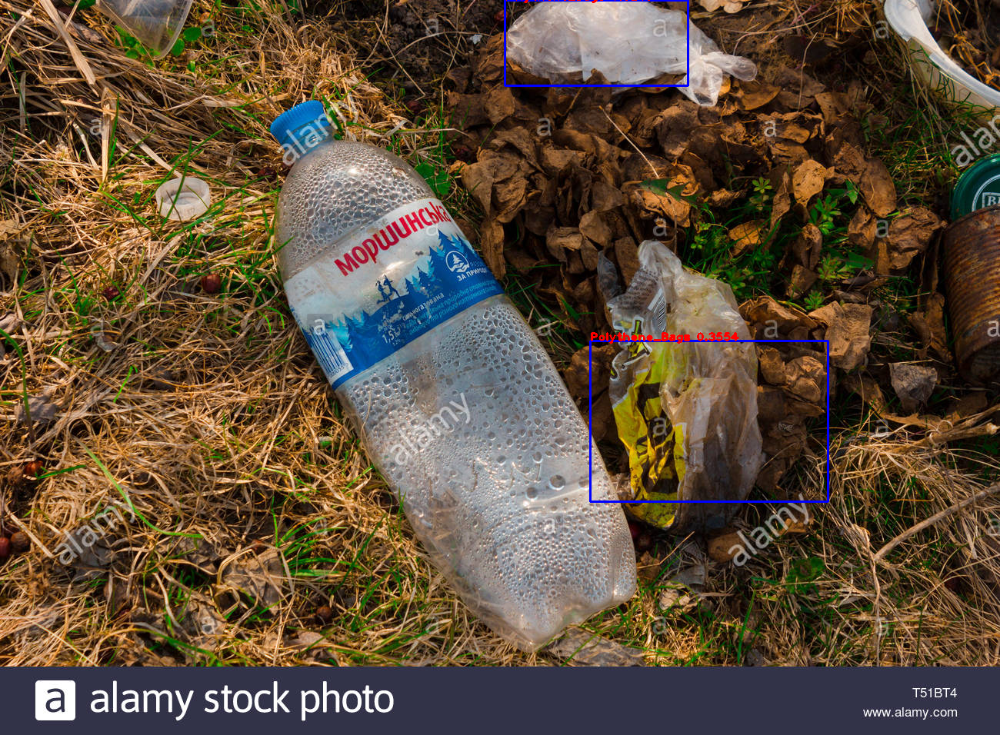

In [29]:
show_output("/content/garbage-waste-plastic-waste-garbage-plastic-bottle-background-texture-garbage-waste-plastic-pollution-T51BT4.jpg")

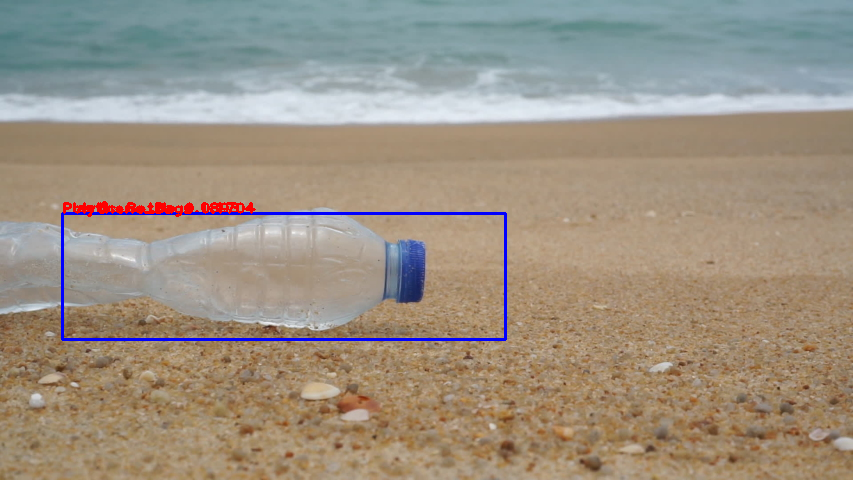

In [18]:
show_output("/content/1.jpg")

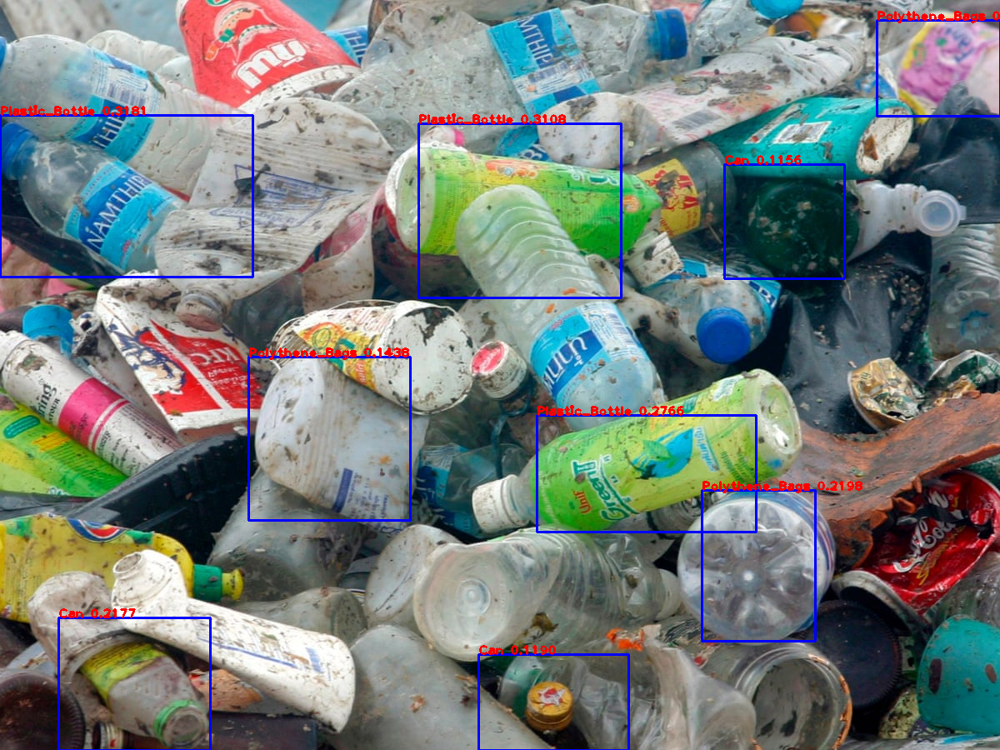

In [35]:
show_output("/content/drive/MyDrive/test_img/2370.jpg")

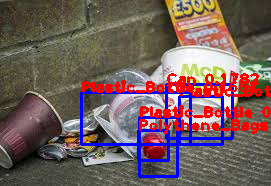

In [57]:
show_output("/content/drive/MyDrive/test_img/WhatsApp Image 2021-06-15 at 5.55.58 PM.jpeg")

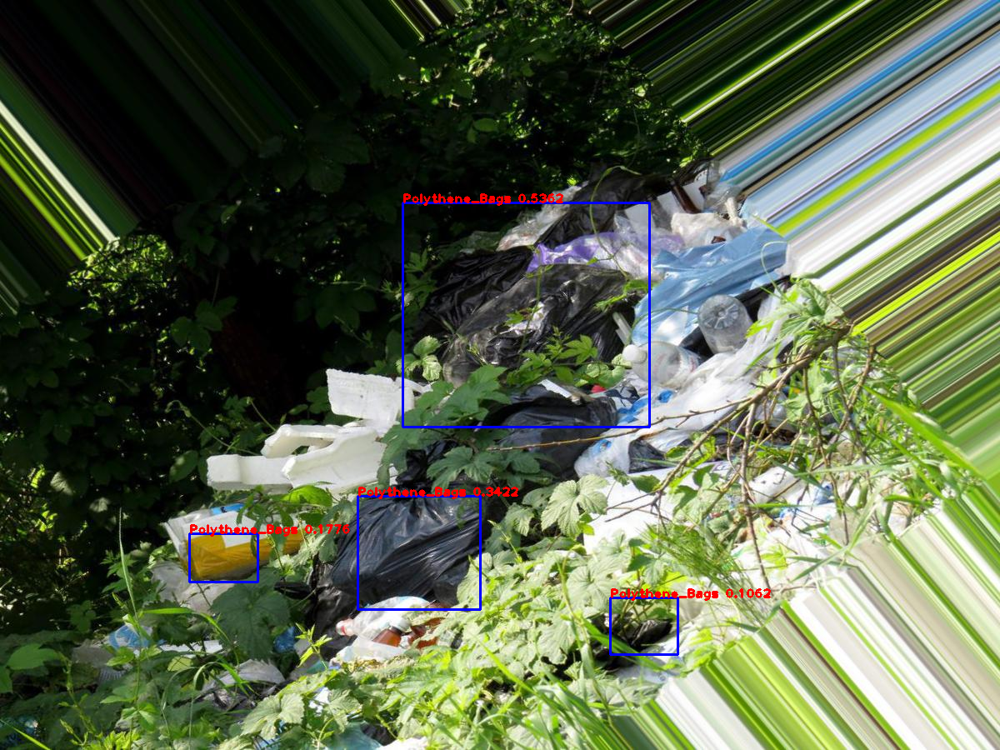

In [41]:
show_output("/content/drive/MyDrive/darknet/data/Images/garbage_1307.jpg")

In [42]:
!wget https://eartheclipse.com/wp-content/uploads/2017/07/garbage-plastic-waste-waste.jpg

--2021-06-24 19:32:55--  https://eartheclipse.com/wp-content/uploads/2017/07/garbage-plastic-waste-waste.jpg
Resolving eartheclipse.com (eartheclipse.com)... 104.19.154.92, 104.19.155.92, 2606:4700::6813:9a5c, ...
Connecting to eartheclipse.com (eartheclipse.com)|104.19.154.92|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 111466 (109K) [image/jpeg]
Saving to: ‘garbage-plastic-waste-waste.jpg’

garbage-plastic-was 100%[===================>] 108.85K  --.-KB/s    in 0.02s   

2021-06-24 19:32:55 (4.64 MB/s) - ‘garbage-plastic-waste-waste.jpg’ saved [111466/111466]



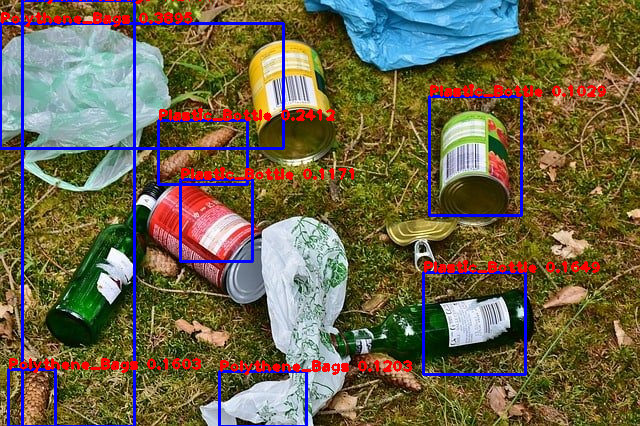

In [51]:
show_output("/content/garbage-plastic-waste-waste.jpg")

In [55]:
!wget https://news.cgtn.com/news/2021-01-15/Heavy-rains-turn-Bulgaria-s-longest-river-into-garbage-river--X4seceiRR6/img/6d5f87bb232341e3b21273807ae5075b/6d5f87bb232341e3b21273807ae5075b.jpeg

--2021-06-24 19:40:56--  https://news.cgtn.com/news/2021-01-15/Heavy-rains-turn-Bulgaria-s-longest-river-into-garbage-river--X4seceiRR6/img/6d5f87bb232341e3b21273807ae5075b/6d5f87bb232341e3b21273807ae5075b.jpeg
Resolving news.cgtn.com (news.cgtn.com)... 205.185.216.10, 205.185.216.42, 2001:4de0:ac19::1:b:1a, ...
Connecting to news.cgtn.com (news.cgtn.com)|205.185.216.10|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1635952 (1.6M) [image/jpeg]
Saving to: ‘6d5f87bb232341e3b21273807ae5075b.jpeg’

6d5f87bb232341e3b21 100%[===================>]   1.56M  1.53MB/s    in 1.0s    

2021-06-24 19:40:57 (1.53 MB/s) - ‘6d5f87bb232341e3b21273807ae5075b.jpeg’ saved [1635952/1635952]



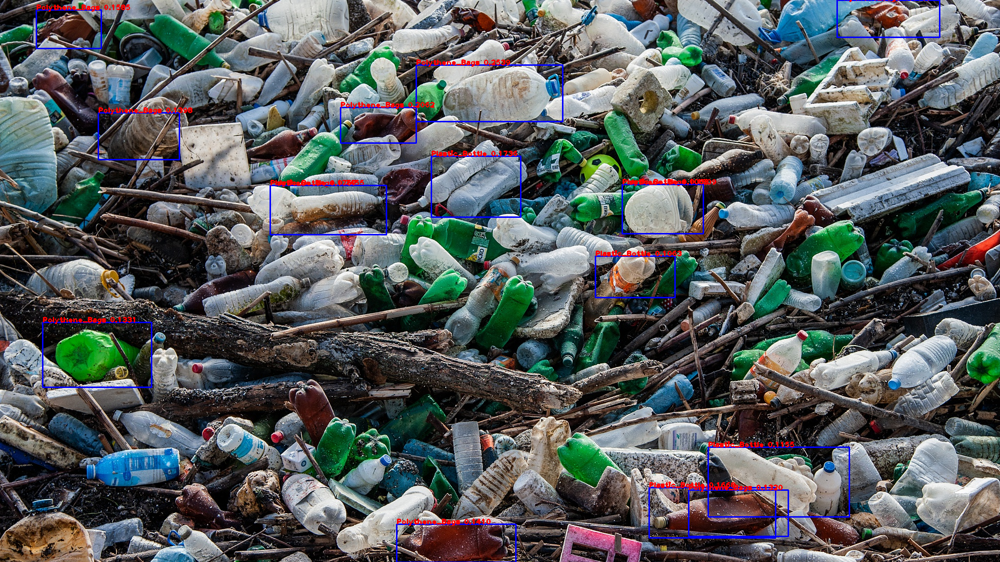

In [59]:
show_output("/content/6d5f87bb232341e3b21273807ae5075b.jpeg")

In [60]:
!wget /content/drive/MyDrive/4TH_year_project/trashnet_dataset/Dataset_to_be_used_for_yolo/Yolo_Annotations/Yolo_Annotation_Images/garbage_1036.jpg

/content/drive/MyDrive/4TH_year_project/trashnet_dataset/Dataset_to_be_used_for_yolo/Yolo_Annotations/Yolo_Annotation_Images/garbage_1036.jpg: Scheme missing.


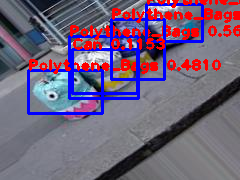

In [61]:
show_output("/content/drive/MyDrive/4TH_year_project/trashnet_dataset/Dataset_to_be_used_for_yolo/Yolo_Annotations/Yolo_Annotation_Images/garbage_1036.jpg")

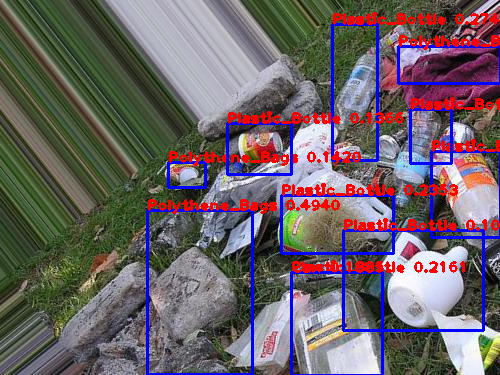

In [68]:
show_output("/content/drive/MyDrive/4TH_year_project/trashnet_dataset/Dataset_to_be_used_for_yolo/Yolo_Annotations/Yolo_Annotation_Images/garbage_49.jpg")

In [ ]:
import pandas as pd

In [ ]:
data = pd.read_csv("/content/drive/MyDrive/darknet/out_csv.csv")

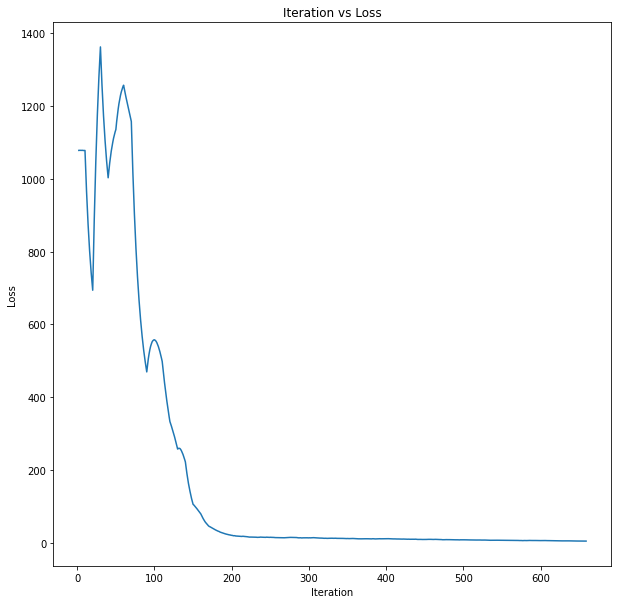

In [ ]:
plt.figure(figsize=(10,10))
plt.plot(data["Iteration"],data["Loss_value"])
plt.title("Iteration vs Loss")
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.show()

In [ ]:
#####################################################################################################

In [ ]:
import cv2

In [ ]:
def out_vid(image):
    image = np.array(image)
    image = tf.expand_dims(image, 0)
    resized_frame = resize_image(image, (model_size[0],model_size[1]))
    pred = model.predict(resized_frame)
    boxes, scores, classes, nums = output_boxes( \
        pred, model_size,
        max_output_size=max_output_size,
        max_output_size_per_class=max_output_size_per_class,
        iou_threshold=iou_threshold,
        confidence_threshold=confidence_threshold)
    image = np.squeeze(image)
    img = draw_outputs(image, boxes, scores, classes, nums, class_names)
    return img

In [ ]:
import cv2
import numpy as np

cap = cv2.VideoCapture('/content/drive/MyDrive/test_img/New video fin.mp4')
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))

if (cap.isOpened()== False):
    print("Error opening video stream or file")

out = cv2.VideoWriter('outpy.avi',cv2.VideoWriter_fourcc('M','J','P','G'), 10, (frame_width,frame_height))
 
while(cap.isOpened()):

  ret, frame = cap.read()

  if ret == True:
      out_img = out_vid(frame)
      out.write(out_img)
      
      if cv2.waitKey(25) & 0xFF == ord('q'):
        break

 

  else:

    break

cap.release()
out.release()

cv2.destroyAllWindows()


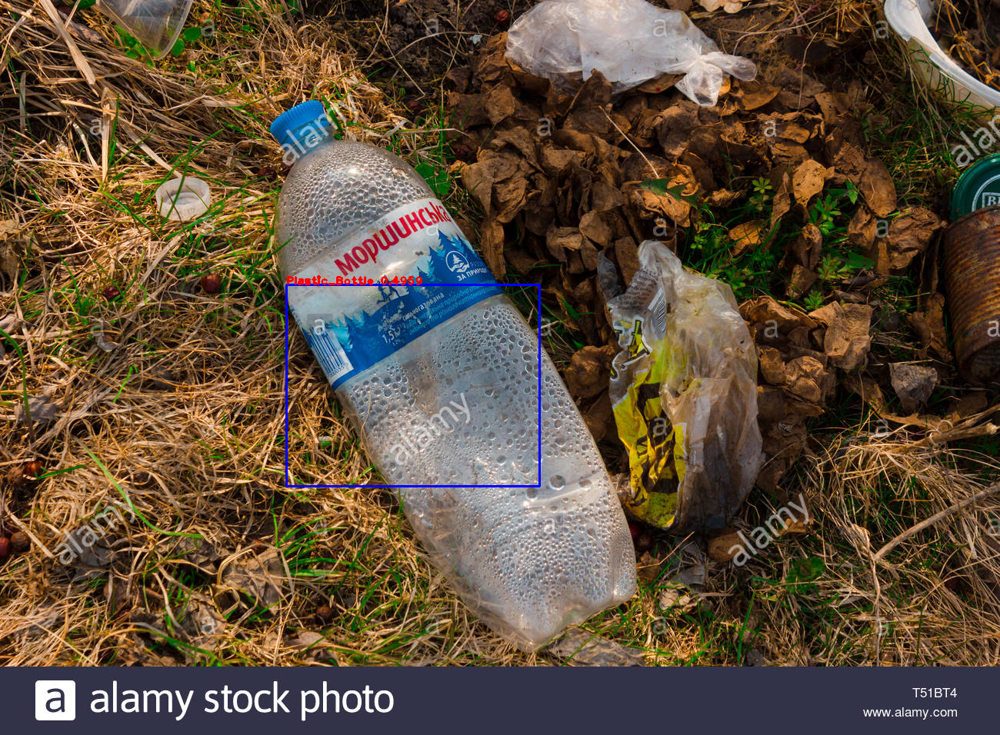